In [1]:
import flowshape as fs
import igl
import numpy as np
import meshplot as mp
import os
import pandas as pd
from src.utilities.fin_shape_utils import plot_mesh
from src.utilities.fin_class_def import FinData
from src.utilities.functions import path_leaf
import glob2 as glob
import meshplot as mp
import trimesh

from sklearn.decomposition import PCA

import plotly.express as px
import plotly.graph_objects as go

## We're just gonna go for it!

### Load SH data

In [2]:
# get list of refined fin mesh objects
root = "/media/nick/hdd02/Cole Trapnell's Lab Dropbox/Nick Lammers/Nick/pecfin_dynamics/"
fin_mesh_list = sorted(glob.glob(os.path.join(root, "point_cloud_data", "processed_fin_data", "*smoothed_fin_mesh*")))

# load metadata
# metadata_df = pd.read_csv(os.path.join(root, "metadata", "master_metadata.csv"))
# metadata_df["experiment_date"] = metadata_df["experiment_date"].astype(str)
# metadata_df.head()

# load SH data
sh_dir = os.path.join(root, "point_cloud_data", "SH_analysis", "")
SH_df = pd.read_csv(os.path.join(sh_dir, "fin_sh_df_aligned.csv"))

# drop FGF 30hr that is breaking the SH fits 
SH_df = SH_df.drop(index=37)

y_subdir = os.path.join(sh_dir, "Y_matrices")
y_data_list = sorted(glob.glob(y_subdir + "/*"))

SH_df.head()

,time_index,well_index,estimated_stage_hpf,genotype,nd2_series,chem_i,experiment_date,chem_id,chem_time,scale,...,sh_l029_m049,sh_l029_m050,sh_l029_m051,sh_l029_m052,sh_l029_m053,sh_l029_m054,sh_l029_m055,sh_l029_m056,sh_l029_m057,sh_l029_m058
0,155,2,41.784707,wt,3,NaN,20240619,WT,NaN,85.686056,...,-0.056949,0.042998,-0.066082,-0.003099,0.034600,-0.123294,-0.125870,-0.017210,-0.121879,0.070869
1,0,0,50.000156,wt,1,DMSO_24,20240711_01,DMSO,24.0,61.601334,...,-0.115353,-0.065863,-0.026955,0.032426,0.100551,0.074502,0.045902,0.061831,0.069477,-0.085305
2,0,1,50.005733,wt,2,shh_24,20240711_01,shh,24.0,59.691705,...,-0.007827,0.003944,0.104124,0.017772,0.110996,-0.058319,0.018776,-0.032077,0.050656,-0.185248
3,0,2,50.011715,wt,3,notch_24,20240711_01,notch,24.0,59.526956,...,0.025897,0.014222,0.010021,-0.033158,0.050874,0.008345,0.060315,0.128052,0.013312,0.229254
4,0,3,50.017035,wt,4,Wnt_24,20240711_01,Wnt,24.0,45.595272,...,0.304811,0.193479,0.008246,-0.172476,0.043811,0.002637,-0.116471,-0.035238,0.033676,-0.162896


### Peform simple PCA analysis on SH weights

In [3]:
def get_sh_colnames(max_degree):

    col_names = []
    l_id_vec = []
    m_id_vec = []
    for l in range(max_degree):
        
        i1 = l**2
        i2 = (l + 1) ** 2

        for m in range(i1, i2):
            col_name = f"sh_l{l:03}_m{m-i1:03}"
            col_names.append(col_name)

            l_id_vec.append(l)
            m_id_vec.append(m-l)
            
    return col_names, l_id_vec, m_id_vec

In [4]:


n_components = 10
max_degree = 15
# get matrix of SH weights
# sh_cols = [col for col in SH_df.columns if "sh_l" in col]
sh_cols, _, _ = get_sh_colnames(max_degree=max_degree)
scale_vec = SH_df["scale"].copy().to_numpy()[:, None]
scale_vec /= np.max(scale_vec)
sh_array = np.divide(SH_df.loc[:, sh_cols].to_numpy(), scale_vec)

# sh_array = SH_df.loc[:, sh_cols].to_numpy()
# scale_vec = SH_df["scale"].to_numpy()
# scale_vec = scale_vec - np.mean(scale_vec)
# scale_vec = scale_vec / np.amax(scale_vec)

# sh_array = np.c_[scale_vec[:, None], sh_array]

# initialize PCA
pca = PCA(n_components=n_components)
pca.fit(sh_array)

# transform the SH array
sh_pca_array = pca.transform(sh_array)
sh_pca_array.shape

(222, 10)

### How many PC's do we need to capture most of the shape variance?

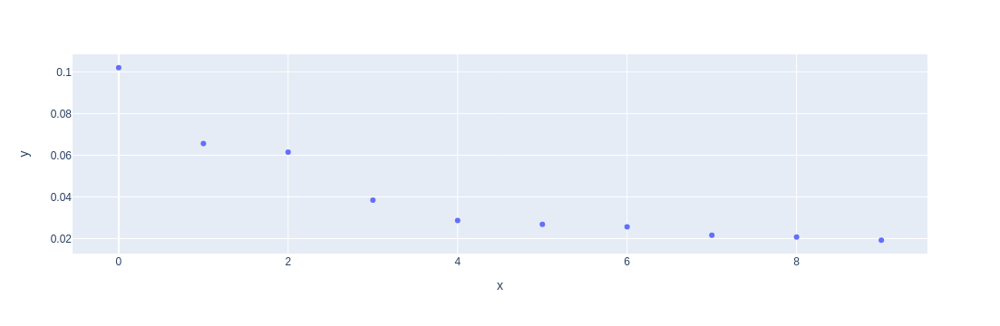

In [5]:
var_vec = pca.explained_variance_ratio_

fig = px.scatter(x=np.arange(n_components), y=var_vec)
fig.show()

### Let's look at the first fiew PCA components

In [6]:
plot_filter = (SH_df["estimated_stage_hpf"]<=60).to_numpy()
SH_df["chem_time_str"] = SH_df["chem_time"].astype(str)

fig = px.scatter_3d(SH_df.loc[plot_filter, :], x=sh_pca_array[plot_filter, 0], y=sh_pca_array[plot_filter, 1], 
                    z=sh_pca_array[plot_filter, 2],
                 color="chem_id", symbol="chem_time_str")
fig.update_traces(marker=dict(size=3))
fig.show()

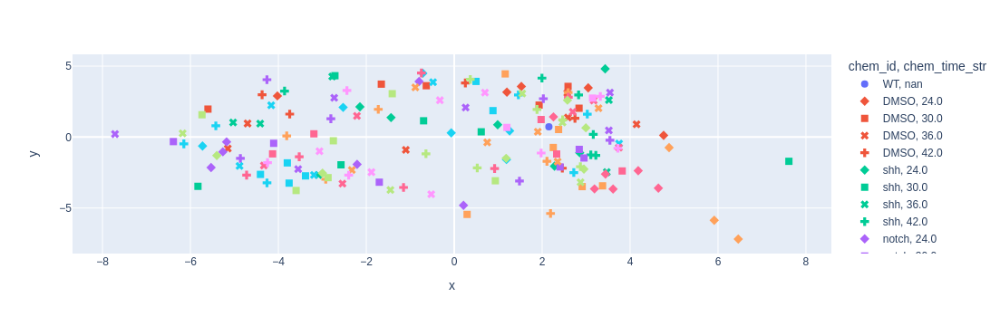

In [9]:
plot_filter = (SH_df["estimated_stage_hpf"]<=60).to_numpy()
SH_df["chem_time_str"] = SH_df["chem_time"].astype(str)

fig = px.scatter(SH_df.loc[plot_filter, :], x=sh_pca_array[plot_filter, 0], y=sh_pca_array[plot_filter, 1], 
                 color="chem_id", symbol="chem_time_str")
fig.update_traces(marker=dict(size=8))
fig.show()

### Looks pretty noisy. What about UMAP?

In [10]:
import umap.umap_ as umap

reducer = umap.UMAP(n_components=3)
embedding = reducer.fit_transform(sh_array)
embedding.shape

(222, 3)

In [16]:
SH_df.loc[np.isnan(SH_df["chem_time"]), "chem_time"] = 24

fig = px.scatter_3d(SH_df.loc[plot_filter, :], x=embedding[plot_filter, 0], y=embedding[plot_filter, 1],
                    z=embedding[plot_filter, 2],
                color="chem_id", size="chem_time", hover_data={'experiment_date', "well_index", "time_index"} )
# fig.update_traces(marker=dict(size=5))
fig.show()

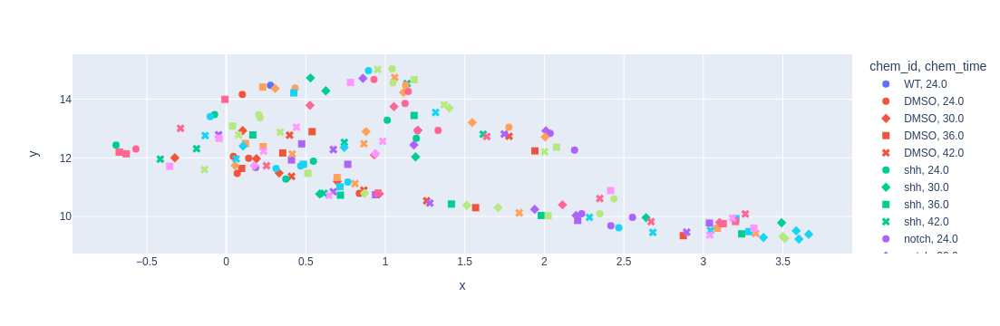

In [19]:
fig = px.scatter(SH_df.loc[plot_filter, :], x=embedding[plot_filter, 0], y=embedding[plot_filter, 1],
                color="chem_id", symbol="chem_time", hover_data={'experiment_date', "well_index", "time_index"} )
fig.update_traces(marker=dict(size=8))
fig.show()

### Let's inspect a few 

#### Case 1: two very different DMSO fins 

In [157]:
well_num00 = 45
date00 = "20240711_01"
name_stub00 = f"{date00}_well{well_num00:04}*"
path00 = fin_mesh_list = sorted(glob.glob(os.path.join(root, "point_cloud_data", "processed_fin_data", name_stub00 + "*smoothed_fin_mesh*")))
fin_mesh00 = trimesh.load(path00[0])

well_num01 = 45
date01 = "20240711_02"
name_stub01 = f"{date01}_well{well_num01:04}*"
path01 = fin_mesh_list = sorted(glob.glob(os.path.join(root, "point_cloud_data", "processed_fin_data", name_stub01 + "*smoothed_fin_mesh*")))
fin_mesh01 = trimesh.load(path01[0])


In [158]:
from plotly.subplots import make_subplots

v0 = fin_mesh00.vertices.copy()
v0 = fs.normalize(v0)
fin_mesh00.vertices = v0

v1 = fin_mesh01.vertices.copy()
v1 = fs.normalize(v1)
fin_mesh01.vertices = v1

_, lines0, mesh0 = plot_mesh(fin_mesh00, surf_alpha=1)
_, lines1, mesh1 = plot_mesh(fin_mesh01, surf_alpha=1)

# fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'scene'}, {'type': 'scene'}]], subplot_titles=("Mesh 1", "Mesh 2"))

fig.add_trace(mesh0, row=1, col=1)
fig.add_trace(lines0, row=1, col=1)

fig.add_trace(mesh1, row=1, col=2)
fig.add_trace(lines1, row=1, col=2)
fig.show()

Eh...kind of similar?

#### Next: look into an RA-i and a DMSO fin that look very similar in SH space. Are they really?

In [154]:
# DMS0
well_num00 = 45
date00 = "20240711_01"
name_stub00 = f"{date00}_well{well_num00:04}*"
path00 = fin_mesh_list = sorted(glob.glob(os.path.join(root, "point_cloud_data", "processed_fin_data", name_stub00 + "*smoothed_fin_mesh*")))
fin_mesh00 = trimesh.load(path00[0])

# RA-i
well_num01 = 8
date01 = "20240711_01"
name_stub01 = f"{date01}_well{well_num01:04}*"
path01 = fin_mesh_list = sorted(glob.glob(os.path.join(root, "point_cloud_data", "processed_fin_data", name_stub01 + "*smoothed_fin_mesh*")))
fin_mesh01 = trimesh.load(path01[0])
print(path01[0])

/media/nick/hdd02/Cole Trapnell's Lab Dropbox/Nick Lammers/Nick/pecfin_dynamics/point_cloud_data/processed_fin_data/20240711_01_well0008_time0000_smoothed_fin_mesh.obj


In [155]:
v0 = fin_mesh00.vertices.copy()
v0 = fs.normalize(v0)
fin_mesh00.vertices = v0

v1 = fin_mesh01.vertices.copy()
v1 = fs.normalize(v1)
fin_mesh01.vertices = v1

_, lines0, mesh0 = plot_mesh(fin_mesh00, surf_alpha=1)
_, lines1, mesh1 = plot_mesh(fin_mesh01, surf_alpha=1)

# fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'scene'}, {'type': 'scene'}]], subplot_titles=("Mesh 1", "Mesh 2"))

fig.add_trace(mesh0, row=1, col=1)
fig.add_trace(lines0, row=1, col=1)

fig.add_trace(mesh1, row=1, col=2)
fig.add_trace(lines1, row=1, col=2)
fig.show()

### OK...let's look at two more 'different' DMSO fins

In [161]:
well_num00 = 14
date00 = "20240711_02"
name_stub00 = f"{date00}_well{well_num00:04}*"
path00 = fin_mesh_list = sorted(glob.glob(os.path.join(root, "point_cloud_data", "processed_fin_data", name_stub00 + "*smoothed_fin_mesh*")))
fin_mesh00 = trimesh.load(path00[0])

well_num01 = 46
date01 = "20240711_01"
name_stub01 = f"{date01}_well{well_num01:04}*"
path01 = fin_mesh_list = sorted(glob.glob(os.path.join(root, "point_cloud_data", "processed_fin_data", name_stub01 + "*smoothed_fin_mesh*")))
fin_mesh01 = trimesh.load(path01[0])


In [162]:
v0 = fin_mesh00.vertices.copy()
v0 = fs.normalize(v0)
fin_mesh00.vertices = v0

v1 = fin_mesh01.vertices.copy()
v1 = fs.normalize(v1)
fin_mesh01.vertices = v1

_, lines0, mesh0 = plot_mesh(fin_mesh00, surf_alpha=1)
_, lines1, mesh1 = plot_mesh(fin_mesh01, surf_alpha=1)

# fig = go.Figure()
fig = make_subplots(rows=1, cols=2, specs=[[{'type': 'scene'}, {'type': 'scene'}]], subplot_titles=("Mesh 1", "Mesh 2"))

fig.add_trace(mesh0, row=1, col=1)
fig.add_trace(lines0, row=1, col=1)

fig.add_trace(mesh1, row=1, col=2)
fig.add_trace(lines1, row=1, col=2)
fig.show()

Well! Here we go. An inverted PD axis. This is something I can at least wrap my head around. Now, I can certainly address this in the build code to a degree, but this also points to the possibility of using alignment in SH space to eliminate "trivial" variability that is due to orientation

### Still super noisy...strange. What about orientation-invariant metrics?

In [95]:
# calculate shape metrics
n_pca_components = 10
max_degree = 25
sh_cols, l_id_vec, m_id_vec = get_sh_colnames(max_degree=25)

# get array
sh_array = SH_df.loc[:, sh_cols].to_numpy()

L_power_array = np.zeros((sh_array.shape[0], max_degree))
for L in range(max_degree):
    sh_vals = sh_array[:, np.asarray(l_id_vec)==L]
    L_power_array[:, L] = np.sum(sh_vals**2, axis=1)

L_power_array = np.c_[scale_vec[:, None], L_power_array]

In [96]:

# initialize PCA
pca2 = PCA(n_components=n_pca_components)
pca2.fit(L_power_array)

# transform the SH array
L_pca_array = pca2.transform(L_power_array)

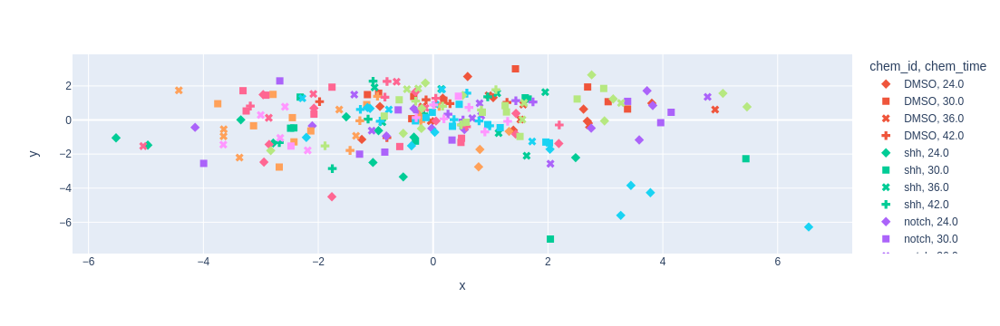

In [98]:
fig = px.scatter(SH_df, x=L_pca_array[:, 0], y=L_pca_array[:, 1], 
                color="chem_id", symbol="chem_time")
fig.update_traces(marker=dict(size=8))
fig.show()